In [1]:
import time
import os
import re
import datetime
import glob

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import japanize_matplotlib
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# ディビジョンを日本語に
def div_ja(division):
    sex = '男子' if division[-1]=='m' else '女子'
    return 'V{0}{1}'.format(division[1], sex)

# 1. ノーマル
ex = ''
index = [
    'AA', 'AP', 'AE', 'ASucc%', 'AP/S', 'BAA', 'BAP', 'BAE', 'BASucc%',
    'BP', 'BP/S', 'SVA', 'SVP', 'SVE', 'SVx', 'SVEff%', 'RA', 'Rx', 'Rg','RSucc%'
]

# # 2. アテンプト数を削除
# ex = '_remove_A'
# index = [
#     'AA', 'AP', 'AE', 'ASucc%', 'AP/S', 'BAA', 'BAP', 'BAE', 'BASucc%',
#     'BP', 'BP/S', 'SVP', 'SVE', 'SVx', 'SVEff%', 'Rx', 'Rg','RSucc%'
# ]

# # 2-1. AP削除
# ex = '_remove_A2'
# index = [
#     'AA', 'AE', 'ASucc%', 'AP/S', 'BAA', 'BAP', 'BAE', 'BASucc%',
#     'BP', 'BP/S', 'SVP', 'SVE', 'SVx', 'SVEff%', 'Rx', 'Rg','RSucc%'
# ]

# # 2-2. AA, AE→AA/S, AE/S
# ex = '_remove_A3'
# index = [
#     'AA/S', 'AP/S', 'AE/S', 'ASucc%', 'BAA', 'BAP', 'BAE', 'BASucc%',
#     'BP', 'BP/S', 'SVP', 'SVE', 'SVx', 'SVEff%', 'Rx', 'Rg','RSucc%'
# ]


# # removeAに%データ追加
# ex = '_add_par'
# index = [
#     'AA', 'ASucc%', 'AEff%', 'AE%', 'AP/S', 'BAA', 'BAP', 'BAE', 'BASucc%',
#     'BP', 'BP/S', 'SVP', 'SVE', 'SVx', 'SVEff%', 'Rx', 'Rg','RSucc%'
# ]

# # 主要スタッツのみ
# ex = '_simple1'
# index = [
#     'ASucc%', 'BASucc%', 'BP/S', 'SVEff%', 'RSucc%'
# ]

# # サーブについてのみ 
# ex = '_SV'
# index = [
#     'SVA', 'SVP', 'SVE', 'SVx', 'SVEff%', 
# ]

In [2]:
division = 'v1_m'
paths = glob.glob('database/{}/teamdb_*'.format(division))
paths = paths[-5:]
print(paths)

['database/v1_m\\teamdb_2017-18_regular.csv', 'database/v1_m\\teamdb_2018-19_regular.csv', 'database/v1_m\\teamdb_2019-20_regular.csv', 'database/v1_m\\teamdb_2020-21_regular.csv', 'database/v1_m\\teamdb_2021-22_regular.csv']


In [3]:
df_list = []
for path in paths:
    df_list.append(pd.read_csv(path))

all_df = pd.concat(df_list)
all_df.to_csv('{0}_17-22.csv'.format(division))

In [4]:
all_df['AEff%'] = ((all_df['AP'] - all_df['AE'])*100 / all_df['AA']).round(1)
all_df['AE%'] = (all_df['AE']*100 / all_df['AA']).round(1)
all_df[['ASucc%', 'AEff%', 'AE%']]

,ASucc%,AEff%,AE%
0,41.8,32.6,9.2
1,48.3,40.8,7.5
2,48.8,39.0,9.8
3,46.2,35.9,10.3
4,45.4,42.3,3.1
...,...,...,...
333,45.2,39.1,6.1
334,47.7,40.4,7.3
335,50.9,42.6,8.3
336,56.1,49.0,7.1


In [5]:
all_df['Set'] = all_df['Win_Set'] + all_df['Lose_Set']
# all_df[['Win_Set', 'Lose_Set', 'Set']]
all_df['AE/S'] = (all_df['AE'] / all_df['Set']).round(2)
# all_df[['AE/S', 'AE', 'Set']]
all_df['AA/S'] = (all_df['AA'] / all_df['Set']).round(2)
all_df[['AA/S', 'AA', 'Set']]

,AA/S,AA,Set
0,28.20,141,5
1,29.40,147,5
2,27.33,82,3
3,26.00,78,3
4,32.33,97,3
...,...,...,...
333,28.75,115,4
334,27.25,109,4
335,27.00,108,4
336,24.50,98,4


In [6]:
df4 = pd.DataFrame(index=index)
# for path in paths:
#     # print(path[-14:-12])
#     year = path[-14:-12]
#     df = pd.read_csv(path)
f = lambda x: 1 if x == 'Win' else 0
all_df['SVEff%'] = (all_df['SVP']*100+all_df['SVx']*25-all_df['SVE']*25)/all_df['SVA']
print(all_df['SVEff%'][0])
all_df['Win'] = all_df['Win_Lose'].map(f)
df2 = all_df[index].copy()
# # df2['BASucc%'].replace('-', np.nan, inplace=True)
# # df2['BASucc%'] = df2['BASucc%'].apply(lambda x: np.nan if x == '-' else x).astype(float)
# df2['BASucc%'] = df2['BASucc%'].apply(lambda x: 0 if x == '-' else x).astype(float)
# # df2['BASucc%'] =df2['BASucc%'].astype(float)
df3 = df2.apply(lambda x: (x-x.mean())/x.std(), axis=0)
X = df3 # 説明変数
Y = all_df['Win']
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 0) # 80%のデータを学習データに、20%を検証データにする

lr = LogisticRegression() # ロジスティック回帰モデルのインスタンスを作成
lr_ = lr.fit(X_train, Y_train) # ロジスティック回帰モデルの重みを学習
Y_pred = lr.predict(X_test)
print(accuracy_score(Y_test, Y_pred))
# print(Y_test, Y_pred)
df4[ex] = lr.coef_[0]
df4

0    5.940594
0    5.339806
0    6.372549
0    6.132075
0    3.658537
Name: SVEff%, dtype: float64
0.9107142857142857


,
AA,1.479602
AP,1.759389
AE,-0.126384
ASucc%,1.073012
AP/S,0.166935
BAA,0.127147
BAP,-0.142131
BAE,-0.229876
BASucc%,0.121955
BP,0.528627


In [9]:
import pandas_profiling as pdp
display(pdp.__version__)
pdp.ProfileReport(df2)

'3.0.0'

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
import statsmodels.api as sm
# 2.2
model = sm.Logit(Y,X)
result = model.fit()
r = result.summary().as_csv().replace(' ', '')
start = r.find('coef')
final = r.find('Possiblycompletequasi-separation:')
r2 = r[start-1:final]
# print(r2)

path = 'p-value/p-value{0}.csv'.format(ex)
with open(path, mode='w') as f:
    f.write(r2)

Optimization terminated successfully.
         Current function value: 0.162803
         Iterations 10


In [14]:
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                    Win   No. Observations:                 1396
Model:                          Logit   Df Residuals:                     1376
Method:                           MLE   Df Model:                           19
Date:                Mon, 23 May 2022   Pseudo R-squ.:                  0.7651
Time:                        00:34:43   Log-Likelihood:                -227.27
converged:                       True   LL-Null:                       -967.63
Covariance Type:            nonrobust   LLR p-value:                6.088e-303
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
AA             4.5284      1.629      2.780      0.005       1.336       7.721
AP             0.2405      1.645      0.146      0.884      -2.984       3.465
AE            -0.2337      0.166     -1.405      0.160      -0.560       0.092
ASucc%         2.8588      1.203      2.376      0.017       0.501       5.217
AP/S          -0.3367      0.344     -0.978      0.328      -1.011       0.338
BAA            0.5347      0.703      0.761      0.447      -0.843       1.912
BAP           -0.6976      0.818     -0.853      0.394      -2.300       0.905
BAE           -0.1186      0.160     -0.742      0.458      -0.432       0.195
BASucc%        0.4770      0.547      0.872      0.383      -0.596       1.550
BP            -0.1025      0.831     -0.123      0.902      -1.731       1.526
BP/S           1.7086      0.894      1.911      0.056      -0.044       3.461
SVA            1.2028      0.571      2.108      0.035       0.084       2.321
SVP           -0.2427      0.795     -0.305      0.760      -1.802       1.316
SVE            0.5658      0.399      1.416      0.157      -0.217       1.349
SVx           -0.3764      0.626     -0.601      0.548      -1.604       0.851
SVEff%         1.6864      1.201      1.405      0.160      -0.667       4.040
RA            -5.2194      1.267     -4.120      0.000      -7.702      -2.737
Rx            -0.5826      1.320     -0.442      0.659      -3.169       2.004
Rg            -0.1736      0.492     -0.353      0.724      -1.137       0.790
RSucc%         0.7796      0.959      0.813      0.416      -1.100       2.659
==============================================================================

Possibly complete quasi-separation: A fraction 0.12 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [15]:
p_val_sum = pd.read_csv(path,index_col=0)
p_val_sum

,coef,stderr,z,P>|z|,[0.025,0.975]
AA,4.5284,1.629,2.780,0.005,1.336,7.721
AP,0.2405,1.645,0.146,0.884,-2.984,3.465
AE,-0.2337,0.166,-1.405,0.160,-0.560,0.092
ASucc%,2.8588,1.203,2.376,0.017,0.501,5.217
AP/S,-0.3367,0.344,-0.978,0.328,-1.011,0.338
BAA,0.5347,0.703,0.761,0.447,-0.843,1.912
BAP,-0.6976,0.818,-0.853,0.394,-2.300,0.905
BAE,-0.1186,0.160,-0.742,0.458,-0.432,0.195
BASucc%,0.4770,0.547,0.872,0.383,-0.596,1.550
BP,-0.1025,0.831,-0.123,0.902,-1.731,1.526


In [2]:
# all_index = [
#     'AA', 'AA/S', 'AP', 'AP/S', 'AE', 'AE/S', 'ASucc%', 'AEff%', 'BAA', 'BAP', 'BAE', 'BASucc%',
#     'BP', 'BP/S', 'SVP', 'SVE', 'SVx', 'SVEff%', 'Rx', 'Rg','RSucc%'
# ]
# p_val = pd.DataFrame(index=all_index)
# p_val
print('hello world')
7.4+1.4-3.6-2.8

hello world


2.4000000000000012

In [17]:
if ex=='':
    ex='_'
p_val[[ex]] = p_val_sum[['P>|z|']]
p_val

NameError: name 'p_val' is not defined

In [18]:
import statsmodels.api as sm
# アテンプト数を除く
model = sm.Logit(Y,X)
result = model.fit()
result.summary()

Optimization terminated successfully.
         Current function value: 0.162803
         Iterations 10


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                    Win   No. Observations:                 1396
Model:                          Logit   Df Residuals:                     1376
Method:                           MLE   Df Model:                           19
Date:                Mon, 23 May 2022   Pseudo R-squ.:                  0.7651
Time:                        00:34:47   Log-Likelihood:                -227.27
converged:                       True   LL-Null:                       -967.63
Covariance Type:            nonrobust   LLR p-value:                6.088e-303
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
AA             4.5284      1.629      2.780      0.005       1.336       7.721
AP             0.2405      1.645      0.146      0.884      -2.984       3.465
AE            -0.2337      0.166     -1.405      0.160      -0.560       0.092
ASucc%         2.8588      1.203      2.376      0.017       0.501       5.217
AP/S          -0.3367      0.344     -0.978      0.328      -1.011       0.338
BAA            0.5347      0.703      0.761      0.447      -0.843       1.912
BAP           -0.6976      0.818     -0.853      0.394      -2.300       0.905
BAE           -0.1186      0.160     -0.742      0.458      -0.432       0.195
BASucc%        0.4770      0.547      0.872      0.383      -0.596       1.550
BP            -0.1025      0.831     -0.123      0.902      -1.731       1.526
BP/S           1.7086      0.894      1.911      0.056      -0.044       3.461
SVA            1.2028      0.571      2.108      0.035       0.084       2.321
SVP           -0.2427      0.795     -0.305      0.760      -1.802       1.316
SVE            0.5658      0.399      1.416      0.157      -0.217       1.349
SVx           -0.3764      0.626     -0.601      0.548      -1.604       0.851
SVEff%         1.6864      1.201      1.405      0.160      -0.667       4.040
RA            -5.2194      1.267     -4.120      0.000      -7.702      -2.737
Rx            -0.5826      1.320     -0.442      0.659      -3.169       2.004
Rg            -0.1736      0.492     -0.353      0.724      -1.137       0.790
RSucc%         0.7796      0.959      0.813      0.416      -1.100       2.659
==============================================================================

Possibly complete quasi-separation: A fraction 0.12 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [89]:
import statsmodels.api as sm
# APを除く
model = sm.Logit(Y,X)
result = model.fit()
result.summary()

Optimization terminated successfully.
         Current function value: 0.172892
         Iterations 9


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                    Win   No. Observations:                 1396
Model:                          Logit   Df Residuals:                     1379
Method:                           MLE   Df Model:                           16
Date:                Thu, 19 May 2022   Pseudo R-squ.:                  0.7506
Time:                        15:30:06   Log-Likelihood:                -241.36
converged:                       True   LL-Null:                       -967.63
Covariance Type:            nonrobust   LLR p-value:                8.159e-300
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
AA             5.5624      0.627      8.876      0.000       4.334       6.791
AE            -0.3229      0.160     -2.015      0.044      -0.637      -0.009
ASucc%         3.7495      0.436      8.603      0.000       2.895       4.604
AP/S          -0.7292      0.314     -2.322      0.020      -1.345      -0.114
BAA            0.5851      0.653      0.895      0.371      -0.696       1.866
BAP           -0.8466      0.755     -1.121      0.262      -2.327       0.634
BAE           -0.0839      0.154     -0.544      0.586      -0.386       0.218
BASucc%        0.5971      0.498      1.199      0.230      -0.379       1.573
BP            -0.4343      0.767     -0.566      0.571      -1.938       1.069
BP/S           2.2958      0.832      2.760      0.006       0.666       3.926
SVP            0.5058      0.562      0.900      0.368      -0.595       1.607
SVE            0.2029      0.307      0.661      0.508      -0.398       0.804
SVx            0.2534      0.430      0.589      0.556      -0.590       1.097
SVEff%         0.6277      0.864      0.727      0.467      -1.065       2.321
Rx            -5.8941      0.486    -12.138      0.000      -6.846      -4.942
Rg            -2.0710      0.214     -9.674      0.000      -2.491      -1.651
RSucc%         4.6027      0.386     11.932      0.000       3.847       5.359
==============================================================================

Possibly complete quasi-separation: A fraction 0.14 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [83]:
import statsmodels.api as sm
# ％
model = sm.Logit(Y,X)
result = model.fit()
result.summary()

Optimization terminated successfully.
         Current function value: 0.171856
         Iterations 9


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                    Win   No. Observations:                 1396
Model:                          Logit   Df Residuals:                     1378
Method:                           MLE   Df Model:                           17
Date:                Thu, 19 May 2022   Pseudo R-squ.:                  0.7521
Time:                        15:22:36   Log-Likelihood:                -239.91
converged:                       True   LL-Null:                       -967.63
Covariance Type:            nonrobust   LLR p-value:                1.890e-299
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
AA             5.4289      0.615      8.824      0.000       4.223       6.635
ASucc%        28.3314     17.678      1.603      0.109      -6.316      62.979
AEff%        -28.6665     20.597     -1.392      0.164     -69.035      11.702
AE%           -9.2581      6.394     -1.448      0.148     -21.791       3.275
AP/S          -0.7365      0.316     -2.334      0.020      -1.355      -0.118
BAA            0.5799      0.653      0.888      0.375      -0.701       1.860
BAP           -0.8507      0.756     -1.125      0.260      -2.332       0.631
BAE           -0.0661      0.154     -0.431      0.667      -0.367       0.235
BASucc%        0.5906      0.501      1.179      0.238      -0.391       1.572
BP            -0.4459      0.769     -0.580      0.562      -1.952       1.061
BP/S           2.2980      0.834      2.756      0.006       0.664       3.932
SVP            0.5045      0.565      0.892      0.372      -0.604       1.613
SVE            0.2157      0.308      0.700      0.484      -0.388       0.820
SVx            0.2126      0.433      0.491      0.623      -0.635       1.060
SVEff%         0.6584      0.869      0.758      0.449      -1.044       2.361
Rx            -5.8961      0.487    -12.104      0.000      -6.851      -4.941
Rg            -2.0760      0.215     -9.668      0.000      -2.497      -1.655
RSucc%         4.6244      0.388     11.905      0.000       3.863       5.386
==============================================================================

Possibly complete quasi-separation: A fraction 0.15 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [28]:
import statsmodels.api as sm
# 主要スタッツ
model = sm.Logit(Y,X)
result = model.fit()
result.summary()

Optimization terminated successfully.
         Current function value: 0.308469
         Iterations 8


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                    Win   No. Observations:                 1396
Model:                          Logit   Df Residuals:                     1391
Method:                           MLE   Df Model:                            4
Date:                Tue, 17 May 2022   Pseudo R-squ.:                  0.5550
Time:                        10:48:50   Log-Likelihood:                -430.62
converged:                       True   LL-Null:                       -967.63
Covariance Type:            nonrobust   LLR p-value:                3.236e-231
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ASucc%         1.9872      0.145     13.714      0.000       1.703       2.271
BASucc%        0.0228      0.109      0.209      0.835      -0.191       0.237
BP/S           1.4600      0.117     12.461      0.000       1.230       1.690
SVEff%         1.1880      0.109     10.852      0.000       0.973       1.403
RSucc%         0.5798      0.093      6.210      0.000       0.397       0.763
==============================================================================
"""

In [59]:
import statsmodels.api as sm
# サーブのみ
model = sm.Logit(Y,X)
result = model.fit()
result.summary()

Optimization terminated successfully.
         Current function value: 0.162803
         Iterations 10


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                    Win   No. Observations:                 1396
Model:                          Logit   Df Residuals:                     1376
Method:                           MLE   Df Model:                           19
Date:                Tue, 17 May 2022   Pseudo R-squ.:                  0.7651
Time:                        18:06:05   Log-Likelihood:                -227.27
converged:                       True   LL-Null:                       -967.63
Covariance Type:            nonrobust   LLR p-value:                6.088e-303
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
AA             4.5284      1.629      2.780      0.005       1.336       7.721
AP             0.2405      1.645      0.146      0.884      -2.984       3.465
AE            -0.2337      0.166     -1.405      0.160      -0.560       0.092
ASucc%         2.8588      1.203      2.376      0.017       0.501       5.217
AP/S          -0.3367      0.344     -0.978      0.328      -1.011       0.338
BAA            0.5347      0.703      0.761      0.447      -0.843       1.912
BAP           -0.6976      0.818     -0.853      0.394      -2.300       0.905
BAE           -0.1186      0.160     -0.742      0.458      -0.432       0.195
BASucc%        0.4770      0.547      0.872      0.383      -0.596       1.550
BP            -0.1025      0.831     -0.123      0.902      -1.731       1.526
BP/S           1.7086      0.894      1.911      0.056      -0.044       3.461
SVA            1.2028      0.571      2.108      0.035       0.084       2.321
SVP           -0.2427      0.795     -0.305      0.760      -1.802       1.316
SVE            0.5658      0.399      1.416      0.157      -0.217       1.349
SVx           -0.3764      0.626     -0.601      0.548      -1.604       0.851
SVEff%         1.6864      1.201      1.405      0.160      -0.667       4.040
RA            -5.2194      1.267     -4.120      0.000      -7.702      -2.737
Rx            -0.5826      1.320     -0.442      0.659      -3.169       2.004
Rg            -0.1736      0.492     -0.353      0.724      -1.137       0.790
RSucc%         0.7796      0.959      0.813      0.416      -1.100       2.659
==============================================================================

Possibly complete quasi-separation: A fraction 0.12 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [18]:
np.exp(result.params)

AA         92.607922
AP          1.271864
AE          0.791622
ASucc%     17.439924
AP/S        0.714135
BAA         1.706964
BAP         0.497754
BAE         0.888141
BASucc%     1.611282
BP          0.902549
BP/S        5.521415
SVA         3.329276
SVP         0.784488
SVE         1.760785
SVx         0.686302
SVEff%      5.400218
RA          0.005410
Rx          0.558431
Rg          0.840627
RSucc%      2.180618
dtype: float64

In [38]:
log_model = LogisticRegression()
log_model.fit(X,Y)
log_model.score(X,Y)

0.9319526627218935

In [32]:
Y_test

76     1
269    1
327    0
158    0
200    1
      ..
134    1
65     0
103    1
66     1
275    0
Name: Win, Length: 68, dtype: int64

In [19]:
df = pd.read_csv(paths[0])
df['SVEff%'] = (df['SVP']*100+df['SVx']*25-df['SVE']*25)/df['SVA']
df['SVEff%'][0]
df[index]

,AA,AP,AE,ASucc%,AP/S,BAA,BAP,BAE,BASucc%,BP,BP/S,SVA,SVP,SVE,SVx,SVEff%,RA,Rx,Rg,RSucc%
0,141,59,13,41.8,11.80,37,13,8,35.1,10,2.00,101,5,10,14,5.940594,97,31.0,50.0,57.7
1,147,71,11,48.3,14.20,31,17,0,54.8,7,1.40,113,6,14,13,5.088496,87,22.0,50.0,54.0
2,82,40,8,48.8,13.33,15,6,3,40.0,7,2.33,73,7,9,20,13.356164,50,22.0,22.0,66.0
3,78,36,8,46.2,12.00,16,8,1,50.0,5,1.67,62,2,11,5,0.806452,62,25.0,12.0,50.0
4,97,44,3,45.4,14.67,28,11,2,39.3,3,1.00,66,2,15,19,4.545455,64,30.0,14.0,57.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,68,44,4,64.7,14.67,12,8,2,66.7,13,4.33,73,7,11,21,13.013699,41,11.0,18.0,48.8
164,142,63,12,44.4,12.60,36,18,3,50.0,8,1.60,107,10,18,35,13.317757,87,22.0,21.0,37.4
165,116,49,7,42.2,9.80,35,16,4,45.7,16,3.20,105,6,16,40,11.428571,83,15.0,30.0,36.1
166,76,32,7,42.1,10.67,15,5,4,33.3,5,1.67,57,0,10,16,2.631579,64,31.0,14.0,59.4


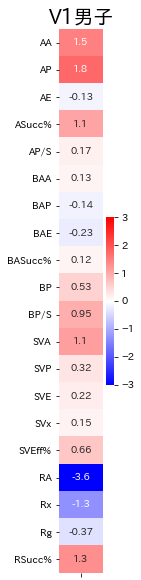

In [21]:
fig = plt.figure(figsize=(1,10))
plt.title(div_ja(division), fontsize=20)
sns.heatmap(df4,annot=True,cmap='bwr',vmin=-3,vmax=3)
plt.savefig('graph/hm/{0}{1}_all.png'.format(division,ex),facecolor='white',bbox_inches="tight")
plt.show()

In [57]:
df4 = pd.DataFrame(index=index)
teams = list(df['Team'].drop_duplicates())
# teams = teams[5:]
df = pd.read_csv(path)
f = lambda x: 1 if x == 'Win' else 0
for team in teams:
    print(team)
    try:
        team_df = df[df['Team']==team].copy()
        team_df['Win'] = team_df['Win_Lose'].map(f)
        df2 = team_df[index].copy()
        # df2['BASucc%'].replace('-', np.nan, inplace=True)
        # df2['BASucc%'] = df2['BASucc%'].apply(lambda x: np.nan if x == '-' else x).astype(float)
        df2['BASucc%'] = df2['BASucc%'].apply(lambda x: 0 if x == '-' else x).astype(float)
        # df2['BASucc%'] =df2['BASucc%'].astype(float)
        df3 = df2.apply(lambda x: (x-x.mean())/x.std(), axis=0)
        X = df3 # 説明変数
        Y = team_df['Win']
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 0) # 80%のデータを学習データに、20%を検証データにする

        lr = LogisticRegression() # ロジスティック回帰モデルのインスタンスを作成
        lr_ = lr.fit(X_train, Y_train) # ロジスティック回帰モデルの重みを学習
        Y_pred = lr.predict(X_test)
        print(accuracy_score(Y_test, Y_pred))
        # print(Y_test, Y_pred)
        df4[team] = lr.coef_[0]
    except:
        print('勝利or敗北が1以下')
df4

ジェイテクトSTINGS
勝利or敗北が1以下
JTサンダーズ広島
勝利or敗北が1以下
VC長野トライデンツ
勝利or敗北が1以下
東レアローズ
勝利or敗北が1以下
堺ブレイザーズ
勝利or敗北が1以下
大分三好ヴァイセアドラー
勝利or敗北が1以下
サントリーサンバーズ
勝利or敗北が1以下
FC東京
勝利or敗北が1以下
パナソニックパンサーズ
勝利or敗北が1以下
ウルフドッグス名古屋
勝利or敗北が1以下


""
SVP
SVE
SVx
SVEff%


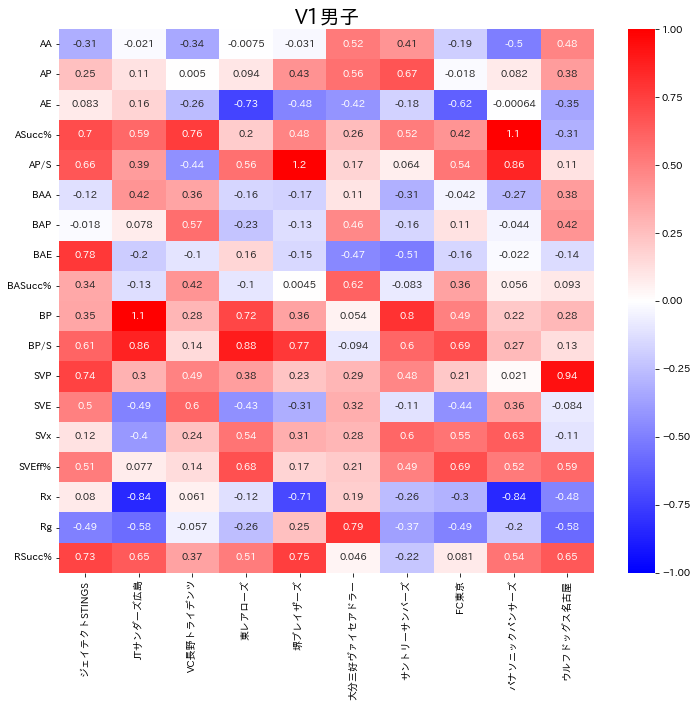

In [44]:
fig = plt.figure(figsize=(12,10))
plt.title(div_ja(division), fontsize=20)
sns.heatmap(df4,annot=True,cmap='bwr',vmin=-1,vmax=1)
plt.savefig('graph/hm/team/{0}_team{1}.png'.format(division,ex),facecolor='white',bbox_inches="tight")
plt.show()

In [45]:
df4

,ジェイテクトSTINGS,JTサンダーズ広島,VC長野トライデンツ,東レアローズ,堺ブレイザーズ,大分三好ヴァイセアドラー,サントリーサンバーズ,FC東京,パナソニックパンサーズ,ウルフドッグス名古屋
AA,-0.314540,-0.021341,-0.336673,-0.007522,-0.030892,0.519142,0.414335,-0.188623,-0.502609,0.480906
AP,0.245357,0.112675,0.004958,0.093785,0.425226,0.557625,0.665921,-0.018345,0.081667,0.383821
AE,0.082673,0.164437,-0.263959,-0.730573,-0.482566,-0.415987,-0.178307,-0.618497,-0.000645,-0.349857
ASucc%,0.698242,0.592190,0.764336,0.195780,0.477739,0.264388,0.515560,0.420563,1.107434,-0.307017
AP/S,0.659427,0.385516,-0.436550,0.555162,1.208425,0.171628,0.064308,0.538863,0.855837,0.111938
BAA,-0.120712,0.420225,0.359305,-0.156904,-0.172260,0.106664,-0.309376,-0.042252,-0.273663,0.383633
BAP,-0.017757,0.077663,0.568651,-0.226609,-0.127579,0.461628,-0.162735,0.113312,-0.044412,0.419971
BAE,0.780620,-0.201936,-0.101883,0.162903,-0.151744,-0.467348,-0.513483,-0.158867,-0.022212,-0.139786
BASucc%,0.336805,-0.132232,0.416503,-0.100770,0.004497,0.616709,-0.083237,0.362548,0.055601,0.092815
BP,0.346419,1.128887,0.281269,0.721061,0.361662,0.054066,0.798908,0.492543,0.217273,0.277697


In [46]:
team_df

,AA,AP,AE,ASucc%,AP/S,BAA,BAP,BAE,BASucc%,BP,...,OpSVA,OpSVP,OpSVE,OpSVx,OpSVEff%,OpRA,OpRx,OpRg,OpRSucc%,Win
9,131,69,9,52.7,13.80,30,15,3,50.0,12,...,112,5,11,33,9.4,84,32.0,13.0,45.8,1
19,99,54,10,54.5,13.50,19,11,2,57.9,5,...,96,2,9,24,6.0,60,29.0,18.0,63.3,0
22,101,52,8,51.5,13.00,16,8,3,50.0,10,...,89,2,16,23,4.2,74,32.0,21.0,57.4,1
34,78,40,5,51.3,13.33,19,11,3,57.9,7,...,69,4,16,20,7.2,57,17.0,23.0,50.0,1
40,94,43,6,45.7,14.33,24,13,2,54.2,10,...,66,0,12,13,0.4,61,24.0,9.0,46.7,1
52,109,54,6,49.5,13.50,22,13,3,59.1,13,...,94,6,23,12,3.5,81,37.0,22.0,59.3,1
63,65,37,4,56.9,12.33,22,13,2,59.1,12,...,49,0,12,10,-1.0,59,22.0,13.0,48.3,1
73,106,55,10,51.9,13.75,24,11,3,45.8,10,...,86,4,11,17,6.4,69,26.0,8.0,43.5,1
84,74,41,7,55.4,13.67,25,12,4,48.0,4,...,74,7,12,21,12.5,50,25.0,10.0,60.0,0
92,97,50,6,51.5,12.50,18,10,2,55.6,12,...,94,8,12,21,10.9,64,24.0,16.0,50.0,0


In [59]:
df4 = pd.DataFrame(index=index)
df5 = pd.DataFrame(index=['Score'])
teams = list(all_df['Team'].drop_duplicates())
# teams = teams[5:]
# df = pd.read_csv(path)
f = lambda x: 1 if x == 'Win' else 0
for team in teams:
    print(team)
    # try:
    team_df = all_df[all_df['Team']==team].copy()
    team_df['Win'] = team_df['Win_Lose'].map(f)
    df2 = team_df[index].copy()
    # df2['BASucc%'].replace('-', np.nan, inplace=True)
    # df2['BASucc%'] = df2['BASucc%'].apply(lambda x: np.nan if x == '-' else x).astype(float)
    # df2['BASucc%'] = df2['BASucc%'].apply(lambda x: 0 if x == '-' else x).astype(float)
    # df2['BASucc%'] =df2['BASucc%'].astype(float)
    df3 = df2.apply(lambda x: (x-x.mean())/x.std(), axis=0)
    X = df3 # 説明変数
    Y = team_df['Win']
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 0) # 80%のデータを学習データに、20%を検証データにする

    lr = LogisticRegression() # ロジスティック回帰モデルのインスタンスを作成
    lr_ = lr.fit(X_train, Y_train) # ロジスティック回帰モデルの重みを学習
    Y_pred = lr.predict(X_test)
    score = accuracy_score(Y_test, Y_pred)
    print(score)
    df5[team] = score
    # print(Y_test, Y_pred)
    df4[team] = lr.coef_[0]
    # except:
        # print('勝利or敗北が1以下')
df4

サントリーサンバーズ
0.6206896551724138
JTサンダーズ
0.6
パナソニックパンサーズ
0.9
FC東京
0.8275862068965517
東レアローズ
0.4827586206896552
豊田合成トレフェルサ
0.7
ジェイテクトSTINGS
0.5862068965517241
堺ブレイザーズ
0.5517241379310345
大分三好ヴァイセアドラー
0.72
VC長野トライデンツ
0.92
ウルフドッグス名古屋
0.47368421052631576
JTサンダーズ広島
0.7


,サントリーサンバーズ,JTサンダーズ,パナソニックパンサーズ,FC東京,東レアローズ,豊田合成トレフェルサ,ジェイテクトSTINGS,堺ブレイザーズ,大分三好ヴァイセアドラー,VC長野トライデンツ,ウルフドッグス名古屋,JTサンダーズ広島
SVP,0.301583,-0.026678,0.405595,0.586407,0.377804,0.028956,0.641580,0.303296,0.429221,0.317448,0.777736,0.033085
SVE,0.275119,-0.335901,-0.554688,-0.249316,0.076656,0.148941,-0.088608,-0.481796,-0.026459,0.253085,-0.476473,-0.446376
SVx,0.338010,-0.245776,-0.203962,0.794970,0.391728,0.929892,0.095038,0.745455,0.995367,0.944945,-0.098892,0.233480
SVEff%,0.572229,0.380241,0.708927,-0.017871,0.544189,0.484102,0.425323,0.223084,-0.609877,-0.339083,-0.015026,0.697058


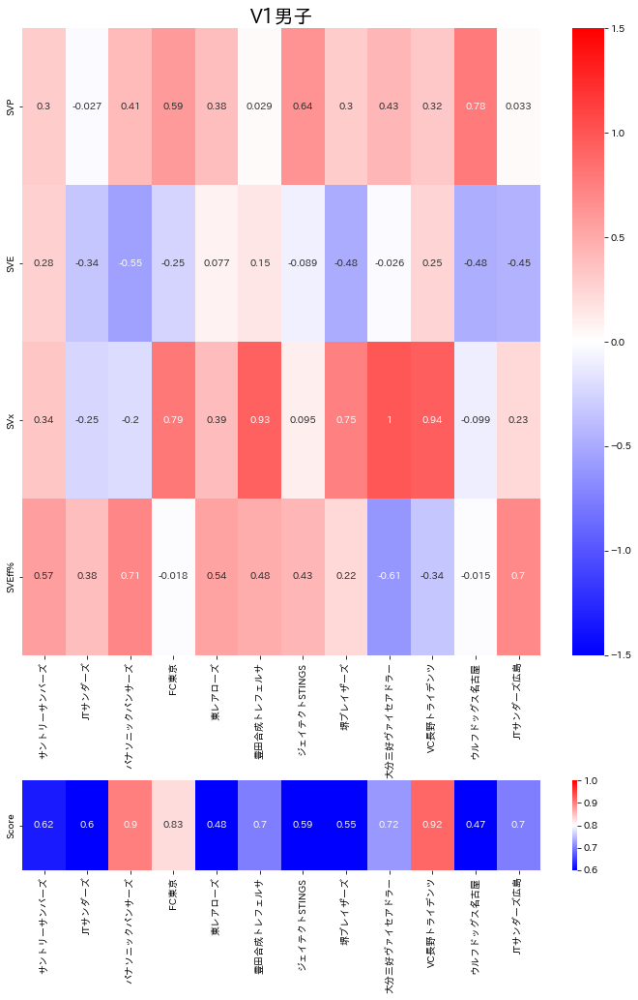

In [60]:
fig = plt.figure(figsize=(12,16))
grid = plt.GridSpec(8,1)
ax1 = fig.add_subplot(grid[0:6,0])
ax2 = fig.add_subplot(grid[7,0])
ax1.set_title(div_ja(division), fontsize=20)
sns.heatmap(df4,annot=True,cmap='bwr',vmin=-1.5,vmax=1.5,ax=ax1)
sns.heatmap(df5,annot=True,cmap='bwr',vmin=0.6,vmax=1,ax=ax2)
plt.savefig('graph/hm/team/{0}_team{1}_00-22.png'.format(division,ex),facecolor='white')
plt.show()

In [27]:
df5

,大同特殊鋼レッドスター,警視庁フォートファイターズ,VC長野トライデンツ,つくばユナイテッドSunGAIA,富士通カワサキレッドスピリッツ,埼玉アザレア,大分三好ヴァイセアドラー,トヨタ自動車サンホークス,長野GaRons,東京ヴェルディ,きんでんトリニティーブリッツ,ヴォレアス北海道,兵庫デルフィーノ,ヴィアティン三重,サフィルヴァ北海道,千葉ZELVA,奈良ドリーマーズ,クボタスピアーズ
0,0.8,0.789474,0.6,0.809524,0.809524,0.9,0.6,1.0,1.0,0.8125,0.8125,0.916667,1.0,0.909091,0.857143,1.0,0.666667,1.0
